<a href="https://colab.research.google.com/github/AfricanLeo/Know-Thy-Customer/blob/main/Know_Thy_Customer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Know Thy Customer

Clever marketers understand that a company’s  best customers are their **existing customers**.  Offering tailor-made solutions to existing clients can strengthen the company’s relationship with a client by showing them that they ‘**know**’ them and ‘**get**’ what they are all about.  

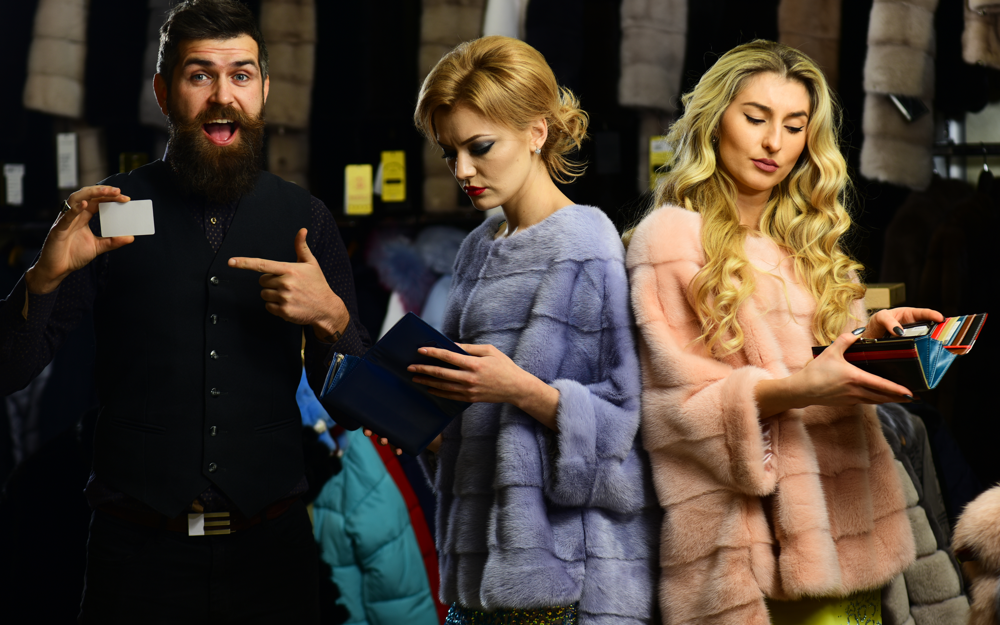

## Customer Segmentation 

Customer segmentation is used by marketing teams to sort customers into groups based on their demographics, behaviour, interests and/or location. 

This divides users into similar or homogeneous groups that exhibit similar traits.  Once these groups are known to the marketing team they can create products that speak to the specific needs of each group. 



## Machine Learning meets the Marketing Team

Machine learning provides the modern marketer with a number of algorithms, tools and techniques to analyse large amounts of data and reveal patterns, correlations, differences and similarities that might be hidden to the naked eye. Clustering algorithms belong to a family of unsupervised learning techniques that does just this.

In this project I will perform a **customer segmentation** on the [Credit Card Dataset](https://www.kaggle.com/arjunbhasin2013/ccdata) from the [Kaggle](https://www.kaggle.com) website using clustering and dimensionality reduction techniques interchangibly. 

The [Credit Card Dataset](https://www.kaggle.com/arjunbhasin2013/ccdata) is a summary of the usage patterns of around 9,000 customers collected by the bank (our client) over a 6 month period.  The dataset measures 18 different features that describe each client and their interaction with their credit facility. More details on these features are available later in the notebook.

 


## Methodology Overview

I will attempt **three different approaches**  to clustering the data and compare the outputs to get to the ideal customer clusters. 


In **Method 1** I will take the dataset with all of it's 17 features and group the clients using the **K-means** clustering algorithm.  The **Elbow method** will help us determine the optimal number of clusters, i.e. the value of *k*.

Once determined, we will use **visualisations** to evaluate and describe the results. 

In **Method 2** we will first reduce the dimensionality of the dataset to 10 features by using the encoded layer of an **Autoencoder artificial neural network**.  

We will then group the **smaller dataset** with **K-means** at different *k-values* and apply the **Elbow method** to find the **optimal k**. 

Once again we will create visual representations of the results to evaluate and compare. 

For **Method 3** we will perform a **RFM Analysis** (recency, frequency and monetary).  This will require us to first categorise the data features into recency-, frequency- and monetary groups.  Once grouped we will work out a score for each category.   

Next we will use the three scores, recency-score, frequency-score and monetary score, run **K-means**, apply the **Elbow method** to find optimal k.  Following this we will again **visualise the clusters**, then **visualise the features** and attempt to **describe** each of the clusters. 

Since our dataset does not have any transaction dates in it, we will have to improvise to find a way to represent the **recency** metric. 


## Shout-outs
This project was inspired by a notebook from a [Udemy courses](https://www.udemy.com) by respected [Prof Ryan Ahmed Ph.D, MBA](https://www.udemy.com/user/ryan-ahmed/) on clustering. 

To find a solution to the **missing data** problem for the **RFM Analysis**, I came across a [comprehensive article](https://towardsdatascience.com/customer-segmentation-using-the-instacart-dataset-17e24be9c0fe) written by JR Kreiger on customer segmentation and how to adapt less than perfect data for a RFM analysis. A huge shout-out for the article, lots of good references and linked code.

I was also able to glean helpful insights into the **practical application of k-means** clustering by reading through [Burak Özen](https://towardsdatascience.com/customer-journey-based-segmentation-for-marketplaces-70e5a56838a7)'s article on K-means and it's limitations. 

## Definitions


### Clustering

> Clustering is a method of **unsupervised learning** that finds similarities and patterns in data points and groups them together accordingly.  This is done without prior knowledge of the data features. 




### K-Means

> **K-means** is one of the best known clustering algorithms in machine learning. It creates *k* homogeneous groups by minimising the Euclidian distance between the data points in a cluster. The number of clusters, *k*, must be provided as an argument. 



> **K-means clustering** does have 2 very important assumptions that can easily ruin your analysis if not taken into account.  These assumptions are:

> 1.   Clusters are spatially grouped or spherical
2.   Clusters are of similar size







### Elbow Method



> Since the optimal number of groups within a dataset is not always known, we can use the k-means algorithm **iteratively** to determine the optimal number of clusters using the **Elbow method**. 


> The definition of the **Elbow method** is a heuristic process of interpretation and validation of consistency within cluster analysis designed to help find the optimal number of clusters in a dataset. 

> When plotted out on a graph, the values look like an arm and the 'elbow' (optimal k) is where the values starts flattening out. 

### Dimensionality Reduction

> Real life datasets often contain huge numbers of features.  This might make it complicated to extract homogeneous groups from the data. 

> There are several ways, automated and manual, that we can reduce the dimensions of the data to get a better handle on what cohorts exist within a dataset. 


### Principal Component Analysis

> **PCA** is an unsupervised machine learning algorithm that performs dimensionality reduction while attempting at keeping the original information unchanged. PCA works by finding composites of features called components. 


### Autoencoder ANN


> An **autoencoder** is a type of artificial neural network used to perform the task of data encoding (representation learning) in an unsupervised manner. 

> The aim of an autoencoder is to learn a representation (encoding) for a set of data, typically for dimensionality reduction, by training the network to ignore signal “noise”.

> Auto encoders use the same data as input and output.  It reduces dimensionality by adding a bottleneck in the network.  The bottleneck is where the encoded (compressed) version of the features are. 


### RFM Analysis

> **RFM Analysis** is an easy and effective segmentation technique that divides types of data into recency, frequency and monetary data bundles and works out a score for each.

> Once the data is segmented this way, algorithms can be performed on the newly formed dataset.

> This technique combines knowledge of the data and the environment in which the data exists with the power of machine learning algorithms. 



  

 



# Setup

##Libraries

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib.colors import LinearSegmentedColormap
from sklearn.preprocessing import StandardScaler, normalize
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA


## Color Palettes

In [ ]:
Classic_Blue    = '#34558b'
Flame_Scarlet   = '#d13b40'
Saffron         = '#ffaf12'
Biscay_Green    = '#4ec5a5'
Chive           = '#565d47'
Faded_Denim     = '#798fa8'
Orange_Peel     = '#fd823e'
Mosaic_Blue     = '#117893'
Sunlight        = '#f0daa4'
Coral_Pink      = '#eaac9d'
Cinnamon_Stick  = '#a2553a'
Grape_Compote   = '#72617d'
Lark            = '#b49c73'
Navy_Blazer     = '#3d3b4d'
Brilliant_White = '#eff0f1'
Ash             = '#a09d9c'

colors = [Classic_Blue, Flame_Scarlet, Saffron, Biscay_Green, 
          Chive, Faded_Denim, Orange_Peel, Mosaic_Blue, 
          Sunlight, Coral_Pink, Cinnamon_Stick, Grape_Compote, 
          Lark, Navy_Blazer, Brilliant_White, Ash]

# Set custom color palette
myPalette   = sns.set_palette(sns.color_palette(colors), n_colors=16)  
sns.color_palette()


[(0.20392156862745098, 0.3333333333333333, 0.5450980392156862),
 (0.8196078431372549, 0.23137254901960785, 0.25098039215686274),
 (1.0, 0.6862745098039216, 0.07058823529411765),
 (0.3058823529411765, 0.7725490196078432, 0.6470588235294118),
 (0.33725490196078434, 0.36470588235294116, 0.2784313725490196),
 (0.4745098039215686, 0.5607843137254902, 0.6588235294117647),
 (0.9921568627450981, 0.5098039215686274, 0.24313725490196078),
 (0.06666666666666667, 0.47058823529411764, 0.5764705882352941),
 (0.9411764705882353, 0.8549019607843137, 0.6431372549019608),
 (0.9176470588235294, 0.6745098039215687, 0.615686274509804),
 (0.6352941176470588, 0.3333333333333333, 0.22745098039215686),
 (0.4470588235294118, 0.3803921568627451, 0.49019607843137253),
 (0.7058823529411765, 0.611764705882353, 0.45098039215686275),
 (0.23921568627450981, 0.23137254901960785, 0.30196078431372547),
 (0.9372549019607843, 0.9411764705882353, 0.9450980392156862),
 (0.6274509803921569, 0.615686274509804, 0.611764705882353)]

In [ ]:
cmap1 = LinearSegmentedColormap.from_list(Classic_Blue, [Faded_Denim, Brilliant_White, Saffron])
cmap2 = LinearSegmentedColormap.from_list(Faded_Denim, [Coral_Pink, Cinnamon_Stick, Grape_Compote])
cmap3 = LinearSegmentedColormap.from_list(Flame_Scarlet, [Saffron, Orange_Peel, Mosaic_Blue])

Color Palette courtesy of Color palette Pantone for Spring Summer 2020 NYFW
via https://simpledits.com

## Functions

**KMeans_Optimal**

This function implements k-means clustering iteratively to determine the optimal number of clusters.

In [ ]:
def kmeans_optimal(df, start, end, color, ls):
  '''
    Calculate the optimal number of kmeans
    
    INPUT:
        df    (DataFrame)   :Dataframe for k-means to fit
        start (int)         :Starting range of kmeans to test
        end   (int)         :Ending range of kmeans to test
        color (str)         :Color of line in plot
        la    (str)         :Line style in plot
    OUTPUT:
        WCSS Scores and plot of WCSS Scores against number of clusters
        scores(list)        :list of WCSS scores
  '''
  scores = []

  range_values = range(start, end)

  for i in range_values:
    kmeans = KMeans(i)
    kmeans.fit(df)
    scores.append(kmeans.inertia_)
  
  plt.plot(scores, color=color, ls=ls, marker='o')
  plt.title('Finding the optimal number of clusters')
  plt.xlabel('Clusters')
  plt.ylabel('WCSS Scores')
  plt.tight_layout()
  plt.show()

  return(scores)

**KMeans**
The KMeans function implements clustering on a dataset and returns the resulting clusters and a t-SNE visualisation of the clusters. 

In [ ]:
def kmeans(df, clusters_nr):

  '''
  Implement k-means clusting on dataset
  INPUT:
        df            (DataFrame)   :Dataset 
        clusters_nr   (int)         :Starting range of kmeans to test
    OUTPUT:
        Cluster results and t-SNE visualisation of clusters
  '''    

  kmeans = KMeans(clusters_nr, random_state = 1)
  kmeans.fit(df)
  
  # Extract cluster labels
  cluster_labels = kmeans.labels_

  #Extract cluster centres
  cluster_centres = kmeans.cluster_centers_
        
  # Create a cluster label column in original dataset
  #df_new = df.assign(Cluster = cluster_labels)
    
  # Initialise TSNE
  tsne_model = TSNE(random_state=1)
  transformed = tsne_model.fit_transform(df)
    
  # Plot t-SNE
  plt.title('Flattened Graph of {} Clusters'.format(clusters_nr))
  sns.scatterplot(x=transformed[:,0], y=transformed[:,1], hue=cluster_labels, 
                  style=cluster_labels, cmap=cmap3)
    
  return cluster_labels, cluster_centres

# Data

## Mount Drive & Load Data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
ccard_df = pd.read_csv('/content/drive/My Drive/PortfolioProjects/Customer_Segmentation/Data/Marketing_data.csv')

## View Dataset

In [ ]:
ccard_df.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


In [ ]:
ccard_df.info()
# 18 features with 8950 points  

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

In [ ]:
ccard_df.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000
mean,1564.474828,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318
std,2081.531879,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000
25%,128.281915,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000
50%,873.385231,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000
75%,2054.140036,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000
max,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000


## Data Source Description

The Credit Card Dataset is a summary of the usage patterns of around 9,000 customers over 6 months.  The dataset measures 18 different features that describe each client and their interaction with their credit facility. 

A quick look at the data dictionary reveals the following information about each feature in the dataset:

**CUSTID** : Identification of Credit Card holder (Categorical)

**BALANCE** : Balance amount left in their account to make purchases

**BALANCE_FREQUENCY**  : How frequently the Balance is updated, score between 0 and 1 (1 = frequently updated, 0 = not frequently updated)

**PURCHASES** : Amount of purchases made from account

**ONEOFF_PURCHASES** : Maximum purchase amount done in one-go

**INSTALLMENTS_PURCHASES** : Amount of purchase done in installment

**CASH_ADVANCE** : Cash in advance given by the user

**PURCHASES_FREQUENCY** : How frequently the Purchases are being made, score between 0 and 1 (1 = frequently purchased, 0 = not frequently purchased)

**ONEOFF_PURCHASES_FREQUENCY** : How frequently Purchases are happening in one-go (1 = frequently purchased, 0 = not frequently purchased)

**PURCHASES_INSTALLMENTS_FREQUENCY** : How frequently purchases in installments are being done (1 = frequently done, 0 = not frequently done)

**CASH_ADVANCE_FREQUENCY** : How frequently the cash in advance being paid

**CASH_ADVANCE_TRX** : Number of Transactions made with "Cash in Advanced"

**PURCHASES_TRX** : Numbe of purchase transactions made

**CREDIT_LIMIT** : Limit of Credit Card for user

**PAYMENTS** : Amount of Payment done by user

**MINIMUM_PAYMENTS** : Minimum amount of payments made by user

**PRC_FULL_PAYMENT** : Percentage of full payments paid by user

**TENURE** : Tenure of credit card service for user

**Data Source: https://www.kaggle.com/arjunbhasin2013/ccdata**

# EDA and Data Visualisation

## Missing Values

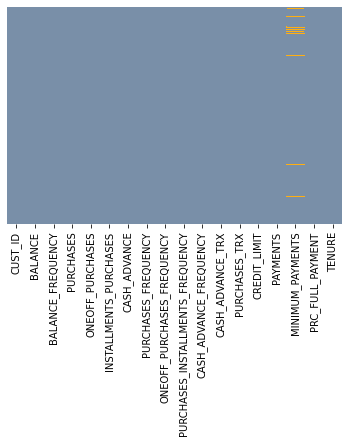

In [ ]:
sns.heatmap(ccard_df.isnull(), yticklabels = False, cbar = False, cmap=cmap1)

In [ ]:
ccard_df.isnull().sum()

CUST_ID                               0
BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

Since there is quite a gap between the mean and median values of this feature, we will up the missing elements with the median value. 

In [ ]:
# Fill up the missing elements with mean of the 'MINIMUM_PAYMENT' 
ccard_df.loc[(ccard_df['MINIMUM_PAYMENTS'].isnull() == True), 'MINIMUM_PAYMENTS'] = ccard_df['MINIMUM_PAYMENTS'].median()


Since there is only one missing Credit Limit value we will fill that with the mean value of the column. 

In [ ]:
# Fill up the missing elements with mean of the 'CREDIT_LIMIT' 
ccard_df.loc[(ccard_df['CREDIT_LIMIT'].isnull() == True), 'CREDIT_LIMIT'] = ccard_df['CREDIT_LIMIT'].mean()

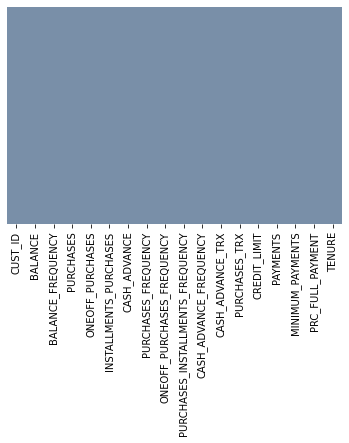

In [ ]:
 sns.heatmap(ccard_df.isnull(), yticklabels = False, cbar = False, cmap=cmap1)

## Duplicate Values

In [ ]:
# Let's see if we have duplicated entries in the data
ccard_df.duplicated().sum()

0

## Redundant Data

In [ ]:
# Let's drop Customer ID since it has no meaning here 
ccard_df.drop("CUST_ID", axis = 1, inplace= True)

## Summary of Dataset

In [ ]:
ccard_n = len(ccard_df.columns)
print('There are ', ccard_n, 'features in the dataset')

There are  17 features in the dataset


In [ ]:
ccard_columns = ccard_df.columns
print('Dataset Columns (Features):\n')
ccard_columns

Dataset Columns (Features):



Index(['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES', 'ONEOFF_PURCHASES',
       'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'PURCHASES_FREQUENCY',
       'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY',
       'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'PURCHASES_TRX',
       'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT',
       'TENURE'],
      dtype='object')

## Vizualise Features

In these plots we will look at the distribution of each of the features in the data.  We will visualise the information using a combination of histograms and kernel density estimation (kde) plots. 

The histograms displays the ranges of data points.  The kernel density estimate demonstrates the probability density at different ranges for continuous variables. 


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function 

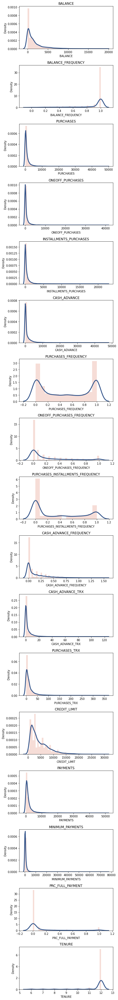

In [ ]:
plt.figure(figsize=(6,50))
for i in range(len(ccard_columns)):
  plt.subplot(17, 1, i+1)
  sns.distplot(ccard_df[ccard_df.columns[i]],
               kde_kws={"color": Classic_Blue, "lw": 3, "label": "KDE"},
               hist_kws={"color": Coral_Pink})
  plt.title(ccard_df.columns[i])

plt.tight_layout()
plt.show()

**Insights**

Mean of balance that a client leaves in their credit card to transact with is approximately $1500.00

Most customers updates their balances frequently ( ~ 1)

Looking at how frequently credit cards in this group of customers are used we see distinct group of customers on opposite ends of the graph. The first group consist of creditcard holders who use the card for everyday purchases.The second group typically use their credit cards less frequently as a type of loan facility or bridging capital to overcome financially tough times.  This will be worth investigating further. 

Oneof purchases don't seem to happen very often, although the maximum value transaction, (USD40k), is quite a bit higher than the average transaction value ($1,5k).  

Very few customers pay their balance in full, PRC_FULL_PAYMENT is almost zero. 

The average credit limit is around USD4,500, but can go up to USD30k, showing another very unequal distribution of values in the dataset. 

The majority of customers in the dataset have and  11+ years tenure.

## Correlation Analysis

Let's explore the correlation between the 17 features in the dataset and visualise those in a heatmap. 

In [ ]:
ccard_corr = ccard_df.corr()


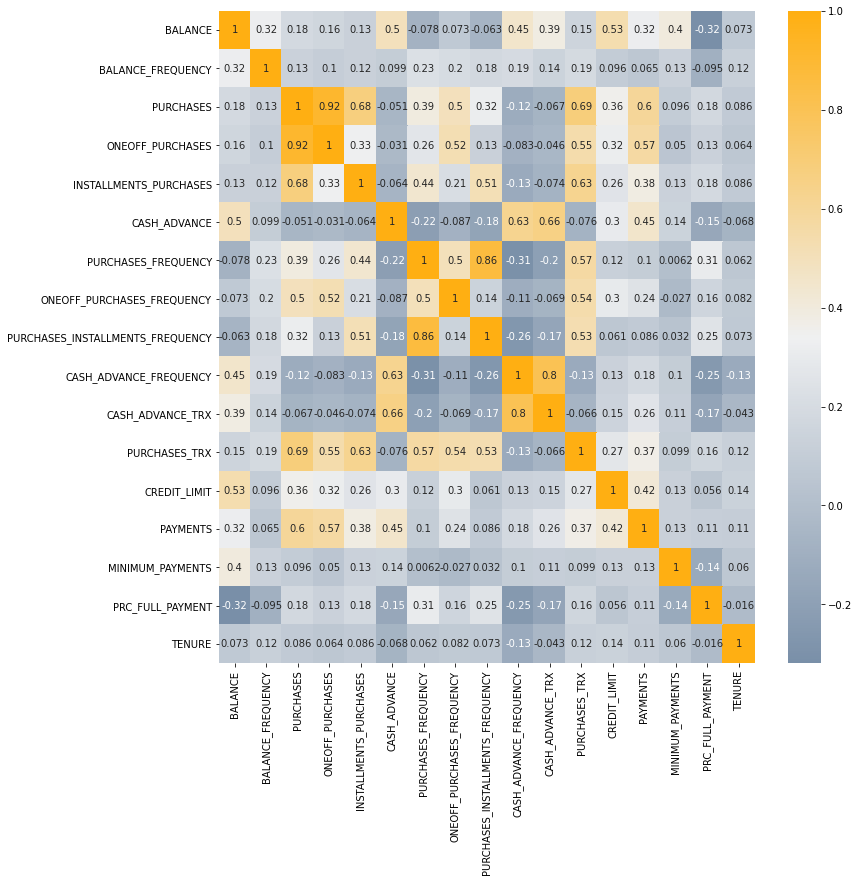

In [ ]:
f, ax = plt.subplots(figsize = (12, 12))
sns.heatmap(ccard_corr, annot = True, cmap=cmap1)

# 'PURCHASES' have high correlation between one-off purchases, 'installment purchases, purchase transactions, credit limit and payments. 
# Strong Positive Correlation between 'PURCHASES_FREQUENCY' and 'PURCHASES_INSTALLMENT_FREQUENCY'


**Insights**

The highest correlation (0.92) seem to be between PURCHASES and ONEOFF_PURCHASES, indicating that the amount spent per transaction seems to correspond to the maximum amount spent in one go. 

There is also a high correlation (0.86) between PURCHASES_INSTALLMENT_FREQUENCY and PURCHASES_FREQUENCY indicating that customers using the credit facility more often, tend to also use the installment purchase option. 

The high correlation between CASH_ADVANCE and CASH_ADVANCE_FREQUENCY (0.8) speaks for itself. 

Users that use their creditcards more regularly has a high correlation to PURCHASES (0.69), so they spend more per transaction. They are also more prone to make use of the INSTALLMENTS_PURCHASES option (0.63)

The negative correlations are also noteworthy with a high negative correlation (-0.32) between the customer's BALANCE and how likely they are to pay their balance in full (PRC_FULL_PAYMENT). In other words the higher the balance left in the account, the least likely a customer is to pay the full amount outstanding. 

The more regular users also show a high negative correlation to clients who make use of cash advances.  



Using these initial insights into how the different behaviour features correspond to each other, we will proceed to three 

# Method 1 : K-Means and the Elbow Method on Full Feature Set

## Scale the Data

Since **k-means** is a spatial algorithm which uses distances between members of a cluster to determine its outcome, the data must be scaled to compensate for different measuring techniques for eaxample $-values of transactions vs. 0-1 measuring of frequency metrics.  

Clustering aims to optimise the within cluster sum of squares (WCSS). 



For this dataset we will not add **weights** to any of the features in the dataset. 

In [ ]:
scaler = StandardScaler()
ccard_df_scaled = scaler.fit_transform(ccard_df)
ccard_df_scaled.shape

(8950, 17)

In [ ]:
ccard_df_scaled

array([[-0.73198937, -0.24943448, -0.42489974, ..., -0.3024    ,
        -0.52555097,  0.36067954],
       [ 0.78696085,  0.13432467, -0.46955188, ...,  0.09749953,
         0.2342269 ,  0.36067954],
       [ 0.44713513,  0.51808382, -0.10766823, ..., -0.0932934 ,
        -0.52555097,  0.36067954],
       ...,
       [-0.7403981 , -0.18547673, -0.40196519, ..., -0.32687479,
         0.32919999, -4.12276757],
       [-0.74517423, -0.18547673, -0.46955188, ..., -0.33830497,
         0.32919999, -4.12276757],
       [-0.57257511, -0.88903307,  0.04214581, ..., -0.3243581 ,
        -0.52555097, -4.12276757]])

## K-Means

Iterate over k-means and plot the WCSS values to find different scores to evaluate for the Elbow method. 

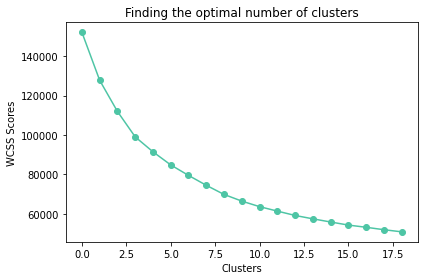

In [ ]:
cc_scores = kmeans_optimal(ccard_df_scaled, 1, 20, Coral_Pink , '-')

The Elbow starts to bend at 4 but the values only seem to start flattening out at 7.5.  We will take 8 as our 'elbow-value'. 

A best practive when selecting the optimal k is to evaluate k, k-1 and k+1.  

We will look at the result of 7, 8 and 9 clusters. 

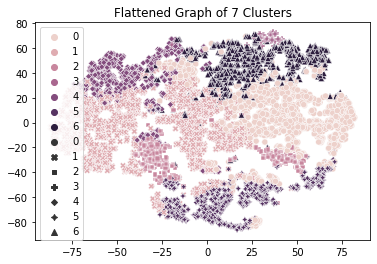

In [ ]:
ccard_labels, ccard_cluster_centres = kmeans(ccard_df_scaled, 7)

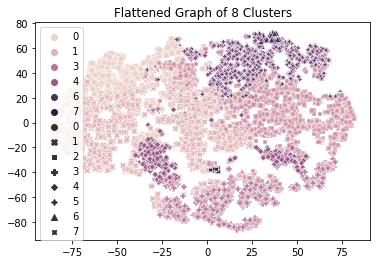

In [ ]:
ccard_labels, ccard_cluster_centres = kmeans(ccard_df_scaled, 8)

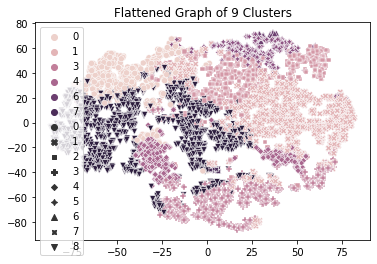

In [ ]:
ccard_labels, ccard_cluster_centres = kmeans(ccard_df_scaled, 9)

Inspecting the cluster visualisations, there seems to be a good deal of **overlapping** in all of the options.  Some clusters are also **scattered** across the graph, so this visualisation does not look like it will give clear guidelines to the marketing team. 

Out of the 3 attempts, a **cluster size of 8** seems to do the best, so we will work with that for the remainder of **Method 1**. 

Let's run k-means for 8 clusters again to view the rest of the data. 

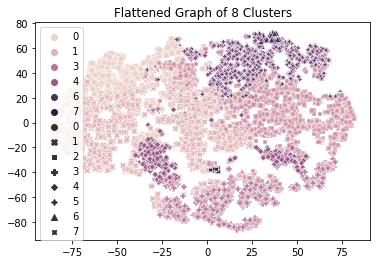

In [ ]:
ccard_labels, ccard_cluster_centres = kmeans(ccard_df_scaled, 8)

## Principal Component Analysis (PCA)



In this analysis I will run the **PCA** with 3 dimensions in order to visualise the clusters in a 3D graph. 

In [ ]:
# Obtain the principal components 
pca = PCA(n_components=3)
principal_comp = pca.fit_transform(ccard_df_scaled)
principal_comp

array([[-1.68362597, -1.07230181,  0.4755914 ],
       [-1.13417269,  2.50910486,  0.602327  ],
       [ 0.96936714, -0.38358185,  0.09104554],
       ...,
       [-0.92889876, -1.80801953, -0.45828133],
       [-2.33778129, -0.65360845,  0.9827464 ],
       [-0.55795543, -0.40057901,  1.03361137]])

In [ ]:
# Create a dataframe with the two components
pca_df = pd.DataFrame(data = principal_comp, columns =['pca1','pca2','pca3'])
# Concatenate the clusters labels to the dataframe
pca_df = pd.concat([pca_df,pd.DataFrame({'cluster':ccard_labels})], axis = 1)
pca_df.head()

,pca1,pca2,pca3,cluster
0,-1.683626,-1.072302,0.475591,1
1,-1.134173,2.509105,0.602327,0
2,0.969367,-0.383582,0.091046,5
3,-0.888250,0.004621,1.499948,1
4,-1.600012,-0.683863,0.347818,1


In [ ]:
pca_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   pca1     8950 non-null   float64
 1   pca2     8950 non-null   float64
 2   pca3     8950 non-null   float64
 3   cluster  8950 non-null   int32  
dtypes: float64(3), int32(1)
memory usage: 244.9 KB


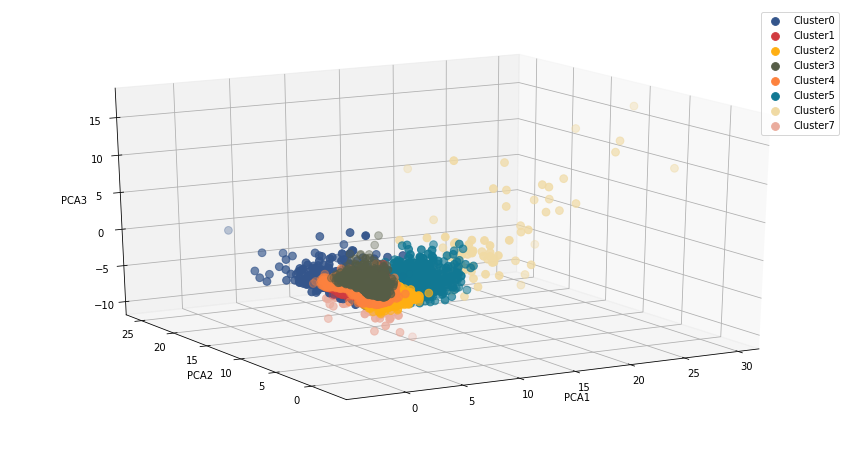

In [ ]:
fig = plt.figure(figsize=(15,8))
ax = fig.add_subplot(111, projection='3d')

scatter0 = ax.scatter(pca_df.pca1[pca_df.cluster==0], pca_df.pca2[pca_df.cluster==0], pca_df.pca3[pca_df.cluster==0],
           c=Classic_Blue, s=60)
scatter1 = ax.scatter(pca_df.pca1[pca_df.cluster==1], pca_df.pca2[pca_df.cluster==1], pca_df.pca3[pca_df.cluster==1],
           c=Flame_Scarlet, s=60)
scatter2 = ax.scatter(pca_df.pca1[pca_df.cluster==2], pca_df.pca2[pca_df.cluster==2], pca_df.pca3[pca_df.cluster==2],
           c=Saffron, s=60)
scatter3 = ax.scatter(pca_df.pca1[pca_df.cluster==3], pca_df.pca2[pca_df.cluster==3], pca_df.pca3[pca_df.cluster==3],
           c=Chive, s=60)
scatter4 = ax.scatter(pca_df.pca1[pca_df.cluster==4], pca_df.pca2[pca_df.cluster==4], pca_df.pca3[pca_df.cluster==4],
           c=Orange_Peel, s=60)
scatter5 = ax.scatter(pca_df.pca1[pca_df.cluster==5], pca_df.pca2[pca_df.cluster==5], pca_df.pca3[pca_df.cluster==5],
           c=Mosaic_Blue, s=60)
scatter6 = ax.scatter(pca_df.pca1[pca_df.cluster==6], pca_df.pca2[pca_df.cluster==6], pca_df.pca3[pca_df.cluster==6],
           c=Sunlight, s=60)
scatter7 = ax.scatter(pca_df.pca1[pca_df.cluster==7], pca_df.pca2[pca_df.cluster==7], pca_df.pca3[pca_df.cluster==7],
           c=Coral_Pink, s=60)

ax.legend([scatter0, scatter1, scatter2, scatter3, scatter4, scatter5, scatter6, scatter7],
          ['Cluster0', 'Cluster1', 'Cluster2', 'Cluster3', 'Cluster4', 'Cluster5', 'Cluster6', 'Cluster7'],
          numpoints = 1)
ax.view_init(20, -120)
plt.xlabel('PCA1')
plt.ylabel('PCA2')
ax.set_zlabel('PCA3')
plt.show()

With the 3D PCA visualisation allows us to see the clusters a bit better but we can still clearly see a good amount of overlapping. 

## Visualise Features per Cluster



### Cluster Centres

We will look at the values of each of the **cluster centres** in order to expand our understanding of the data and the resulting clusters. 

In [ ]:
ccard_cluster_centres = scaler.inverse_transform(ccard_cluster_centres)
ccard_cluster_centres = pd.DataFrame(data = ccard_cluster_centres, columns = ccard_columns)

In [ ]:
ccard_cluster_centres

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,4954.642361,0.970476,564.552788,344.548097,220.117157,5138.698267,0.305587,0.146577,0.201806,0.519830,16.356195,8.722345,8111.675382,4126.149702,1753.076539,3.977793e-02,11.612832
1,1564.838397,0.972313,274.565262,224.744692,49.995562,740.655662,0.167869,0.104238,0.065912,0.149358,2.899576,3.221004,3385.012966,1011.862561,740.586874,2.153013e-02,11.881895
2,778.279265,0.955559,919.635662,209.292542,710.781433,210.831971,0.884555,0.099538,0.830212,0.040017,0.782139,18.957311,3502.242494,1089.901742,635.148635,2.452103e-01,11.854760
3,102.857429,0.370884,346.261400,208.997909,137.513744,302.393308,0.270297,0.074377,0.189012,0.030768,0.678752,4.344857,3866.938823,1144.394972,179.718458,2.401258e-01,11.784148
4,867.527490,0.795881,395.941226,245.976624,150.442309,1116.616899,0.411243,0.121337,0.273164,0.196113,3.237261,5.133758,2465.787340,603.004456,340.320382,1.577381e-01,7.242038
5,1865.964283,0.979288,3090.769371,2129.372614,961.874845,333.950137,0.932246,0.764499,0.582561,0.053702,1.090040,45.253386,7122.890257,2932.855095,749.270211,2.916332e-01,11.928287
6,4662.671853,0.972850,16842.556892,11469.688108,5372.868784,1038.757441,0.920946,0.761835,0.773096,0.073198,2.513514,136.864865,12714.864865,16593.236130,2687.311037,3.961170e-01,11.959459
7,4268.589649,0.985258,893.449189,142.227297,751.221892,957.138029,0.485872,0.043612,0.455979,0.086814,2.837838,19.621622,4517.567568,1466.465369,27628.631071,-8.326673e-17,11.918919


### Individual Features 

Attach cluster labels to original dataframe and visualise the original 17 features for each of the eight clusters. 

In [ ]:
ccard_df_cluster = ccard_df.assign(Cluster = ccard_labels)
ccard_df_cluster.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Cluster
0,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,1
1,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,0
2,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,5
3,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,312.343947,0.000000,12,1
4,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,1


Next we will plot the 8 clusters with their 17 features each in an attempt to understand and get to know your clusters. 

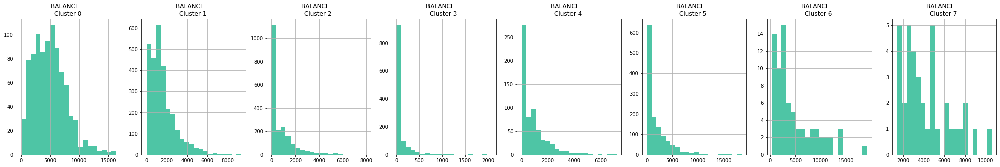

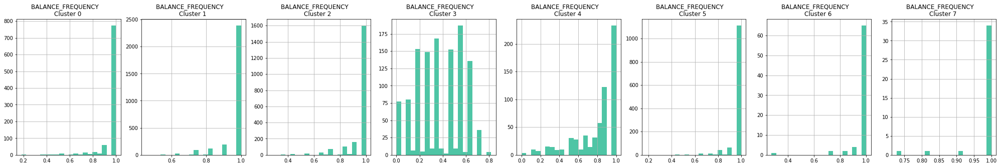

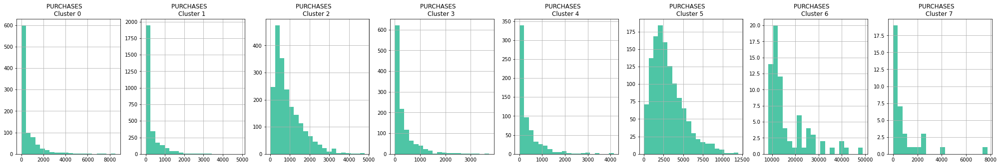

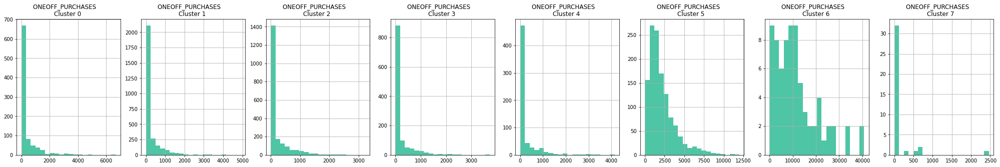

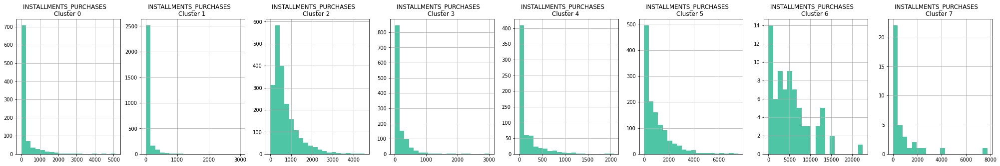

...

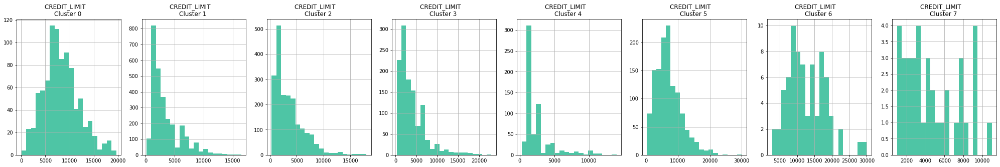

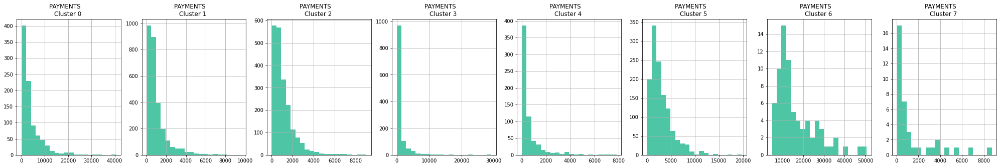

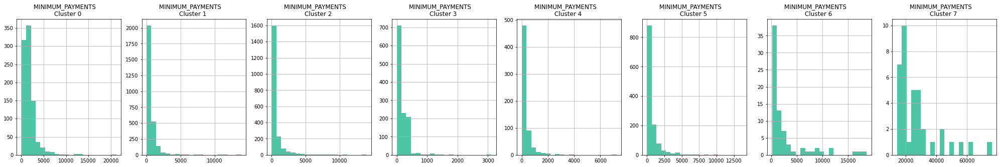

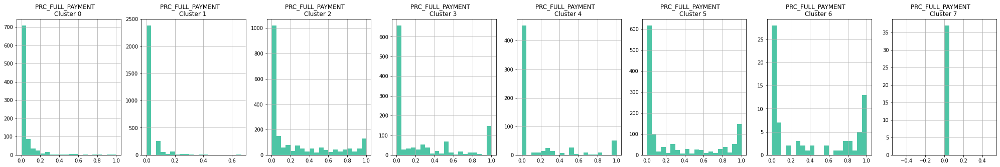

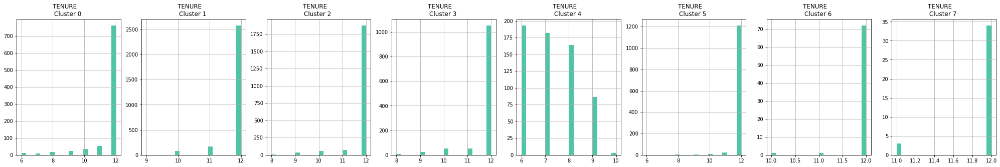

In [ ]:
# Plot the histogram of various clusters
for i in ccard_df.columns:
  plt.figure(figsize = (35, 5))
  for j in range(8):
    plt.subplot(1,8,j+1)
    cluster = ccard_df_cluster[ccard_df_cluster['Cluster'] == j]
    cluster[i].hist(bins = 20, color=Coral_Pink)
    plt.title('{}    \nCluster {} '.format(i,j))
  
  plt.show()

## Cluster Description

Cluster 0 These customers make use of cash advances the most and keep the highest balances.

Cluster 1 These clients do not use their credit cards often, have a lower credit limit and tend to make full payments. 

Cluster 2 These users have lower than average balances, make fewer and smaller sized transactions than the average user. 

Cluster 3 - Cluster with lowest balance, don't transact a lot and use cash advances sparingly. 

Cluster 4 - Newcomers that haven't been with the bank for a long time. They tend to have lower balances, smaller purchases and fewer transactions. 

Cluster 5 - Keep an average balance and make frequent purchases. 

Cluster 6 Keeps a high credit limit and second highest balances.  Makes frequent purchases. 

Cluster 7 - This cluster with the highest minimum payments and with a high balance.

## Conclusion

Evaluating the results we can see that the clustering had some effect since the data in each cluster is more normally distributed than in the first visualisation.  

Although these visualisations contain a wealth of information for the marketing team to mine, analyse and use, there is a lot of overlapping and it is not really presenting us with a clear picture of each of the clusters. 

In the next method we will see if we can improve on this set of clusters. 

# Method 2 : Autoencoders to reduce dimensionality and k-means to cluster the encoded features. 

### Reduce Dimensionality

We will start **method 2** by building an autoencoder neural network that reduces the dimensionality of the dataset to **ten features**.

In [ ]:
from tensorflow.keras.layers import Input, Add, Dense, Activation, ZeroPadding2D, BatchNormalization, Flatten, Conv2D, AveragePooling2D, MaxPooling2D, Dropout
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.initializers import glorot_uniform
from keras.optimizers import SGD

encoding_dim = 7

input_df = Input(shape=(17,))


# Glorot normal initializer (Xavier normal initializer) draws samples from a truncated normal distribution 

x = Dense(encoding_dim, activation='relu')(input_df)
x = Dense(500, activation='relu', kernel_initializer = 'glorot_uniform')(x)
x = Dense(500, activation='relu', kernel_initializer = 'glorot_uniform')(x)
x = Dense(2000, activation='relu', kernel_initializer = 'glorot_uniform')(x)

encoded = Dense(10, activation='relu', kernel_initializer = 'glorot_uniform')(x)

x = Dense(2000, activation='relu', kernel_initializer = 'glorot_uniform')(encoded)
x = Dense(500, activation='relu', kernel_initializer = 'glorot_uniform')(x)

decoded = Dense(17, kernel_initializer = 'glorot_uniform')(x)

# autoencoder
autoencoder = Model(input_df, decoded)

#encoder - used for our dimention reduction
encoder = Model(input_df, encoded)

autoencoder.compile(optimizer= 'adam', loss='mean_squared_error')


In [ ]:
ccard_df_scaled.shape

(8950, 17)

Run the model on the scaled credit card data.

In [ ]:
autoencoder.fit(ccard_df_scaled, ccard_df_scaled, batch_size = 128, epochs = 25,  verbose = 1)

Epoch 1/25
70/70 [==============================] - 5s 60ms/step - loss: 0.7614
Epoch 2/25
70/70 [==============================] - 4s 59ms/step - loss: 0.3633
Epoch 3/25
70/70 [==============================] - 4s 56ms/step - loss: 0.2658
Epoch 4/25
70/70 [==============================] - 4s 56ms/step - loss: 0.2126
Epoch 5/25
70/70 [==============================] - 4s 55ms/step - loss: 0.1886
Epoch 6/25
70/70 [==============================] - 4s 55ms/step - loss: 0.1682
Epoch 7/25
70/70 [==============================] - 4s 56ms/step - loss: 0.1494
Epoch 8/25
70/70 [==============================] - 4s 57ms/step - loss: 0.1424
Epoch 9/25
70/70 [==============================] - 4s 58ms/step - loss: 0.1293
Epoch 10/25
70/70 [==============================] - 4s 57ms/step - loss: 0.1201
Epoch 11/25
70/70 [==============================] - 4s 58ms/step - loss: 0.1061
Epoch 12/25
70/70 [==============================] - 4s 56ms/step - loss: 0.1068
Epoch 13/25
70/70 [==================

In [ ]:
autoencoder.save_weights('autoencoder.h5')

Extract the 'bottleneck' with only 10 features by running a prediction on the Encoder level.

In [ ]:
autoenc_pred = encoder.predict(ccard_df_scaled)

In [ ]:
autoenc_pred.shape

(8950, 10)

## K-Means

Next we will run k-means on the reduced dataset to determine the optimal *k*.

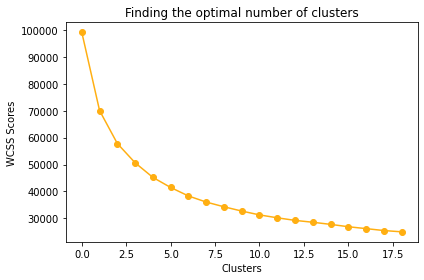

In [ ]:
autoenc_scores = kmeans_optimal(autoenc_pred, 1, 20, Saffron , '-')

Let's compare the WCSS scores with the scores obtained on the full set of 17 features. 

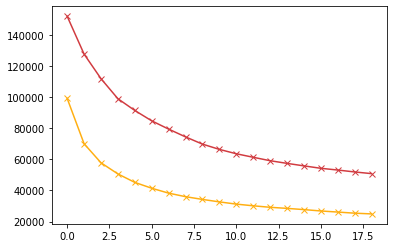

In [ ]:
plt.plot(cc_scores, 'bx-', color = Flame_Scarlet)
plt.plot(autoenc_scores, 'bx-', color = Saffron)

The graph illustrates that the WCSS scores are notably lower when K-Means is performed on the encoded (only 10 features) dataset. The resulting clusters are tighter than those of the previous clustering method. 

The graph already start to flatten between 3 and 4, so we will assume k=4.  Keeping with best practices we will run the algorithm for k-1, k and k+1, in other words, 3, 4 and 5 and inspect the results. 

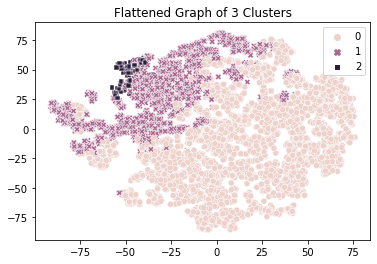

In [ ]:
autoenc_labels, autoenc_cluster_centres = kmeans(autoenc_pred, 3)

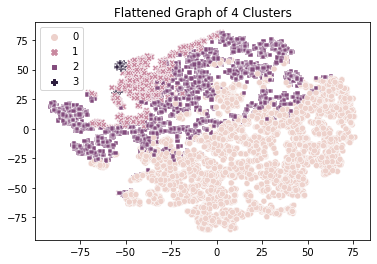

In [ ]:
autoenc_labels, autoenc_cluster_centres = kmeans(autoenc_pred, 4)

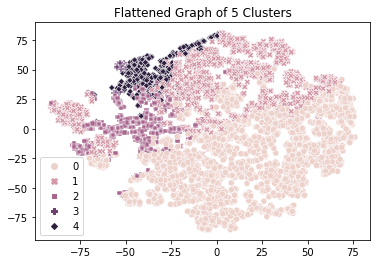

In [ ]:
autoenc_labels, autoenc_cluster_centres = kmeans(autoenc_pred, 5)

On inspecting the three graphs for seperability, *k=3* seems to be where the clusters are better seperated with the least overlapping. 

One **concern** would be that the groups are of a diverse size (number of data-points), potentially violating the **k-means assumption** that the **clusters must be similar in size**. 

In it's attempt to minimize the intra-cluster distances between the points in the large cluster, k-means can “overdo” things and provide non-sendical data.  It is not clear at this point if this is the case. 

One of the most effective ways to **solve** potential clustering issues is to **apply domain knowledge**.  We will do this by visualising the cluster features and see if there are obvious irregularities and/or inconsistencies. 

We will proceed with *k=3*

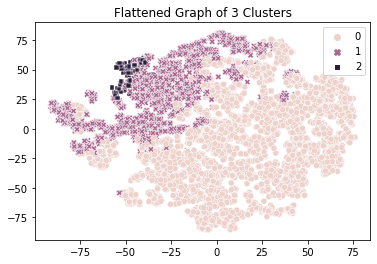

In [ ]:
autoenc_labels, autoenc_cluster_centres = kmeans(autoenc_pred, 3)

## Principal Component Analysis (PCA)

Next, lets run the PCA with 3 dimensions in order to visualise the clusters in a 3D graph.

In [ ]:
pca_autoenc = PCA(n_components=3)
pca_autoenc_comp = pca_autoenc.fit_transform(autoenc_pred)
pca_autoenc_df = pd.DataFrame(data = pca_autoenc_comp, columns =['pca1','pca2', 'pca3'])
pca_autoenc_df = pd.concat([pca_autoenc_df,pd.DataFrame({'cluster':autoenc_labels})], axis = 1)
pca_autoenc_df.head()

,pca1,pca2,pca3,cluster
0,-2.399672,-0.390272,0.134619,0
1,0.645617,2.122542,-0.195374,1
2,-0.592061,-0.591915,1.533306,0
3,-0.578875,0.004723,0.055213,0
4,-2.453104,-0.201394,0.532687,0


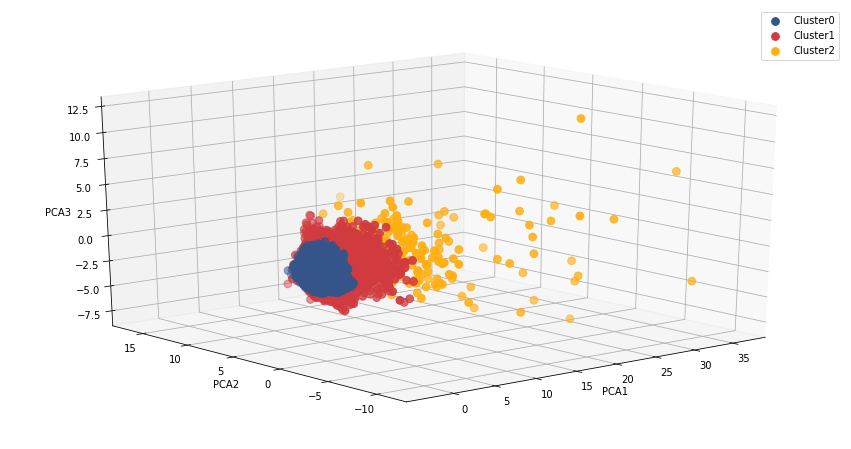

In [ ]:
fig = plt.figure(figsize=(15,8))
ax = fig.add_subplot(111, projection='3d')

scatter0 = ax.scatter(pca_autoenc_df.pca1[pca_autoenc_df.cluster==0], 
                      pca_autoenc_df.pca2[pca_autoenc_df.cluster==0], 
                      pca_autoenc_df.pca3[pca_autoenc_df.cluster==0],
                      c=Classic_Blue, s=60)
scatter1 = ax.scatter(pca_autoenc_df.pca1[pca_autoenc_df.cluster==1], 
                      pca_autoenc_df.pca2[pca_autoenc_df.cluster==1], 
                      pca_autoenc_df.pca3[pca_autoenc_df.cluster==1],
                      c=Flame_Scarlet, s=60)
scatter2 = ax.scatter(pca_autoenc_df.pca1[pca_autoenc_df.cluster==2], 
                      pca_autoenc_df.pca2[pca_autoenc_df.cluster==2], 
                      pca_autoenc_df.pca3[pca_autoenc_df.cluster==2],
                      c=Saffron, s=60)


ax.legend([scatter0, scatter1, scatter2],
          ['Cluster0', 'Cluster1', 'Cluster2'],
          numpoints = 1)
ax.view_init(20, -130)
plt.xlabel('PCA1')
plt.ylabel('PCA2')
ax.set_zlabel('PCA3')
plt.show()

On th3 3D visualisation we can clearly see the 3 visualisations with 2 clusters dense and the third larger and more dispersed. 

## Visualise Features
Let's explore the features of each of the 4 clusters, first by looking at the cluster centres and second 
ly by visualising the original features based on the 3 clusters. 

### Cluster Centres

In [ ]:
autoenc_pred_columns = ['col0', 'col1', 'col2', 'col3', 'col4', 'col5', 'col6', 'col7', 'col8', 'col9']

In [ ]:
autoenc_cluster_centres = pd.DataFrame(data = autoenc_cluster_centres, columns = autoenc_pred_columns)

In [ ]:
autoenc_cluster_centres

,col0,col1,col2,col3,col4,col5,col6,col7,col8,col9
0,0.0,0.0,0.731969,0.799332,0.851242,0.734623,0.0,0.0,1.172975,0.604439
1,0.0,0.0,2.149965,1.914210,2.193724,1.990014,0.0,0.0,2.581642,1.751308
2,0.0,0.0,8.115632,2.770294,4.263700,6.568047,0.0,0.0,5.324114,4.578494


### Individual Features

In [ ]:
ccard_df_autoenc_cluster = ccard_df.assign(Cluster = autoenc_labels)
ccard_df_autoenc_cluster.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Cluster
0,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,0
1,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,1
2,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,0
3,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,312.343947,0.000000,12,0
4,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,0


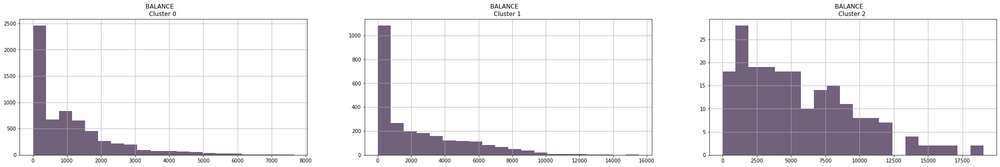

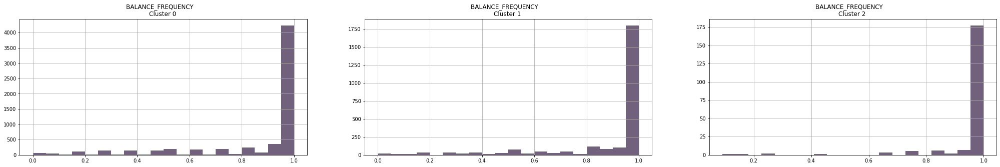

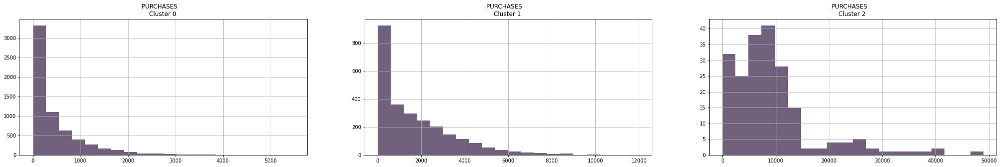

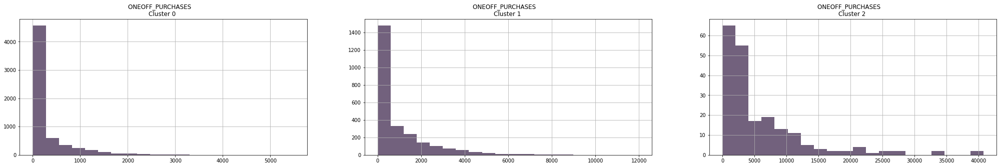

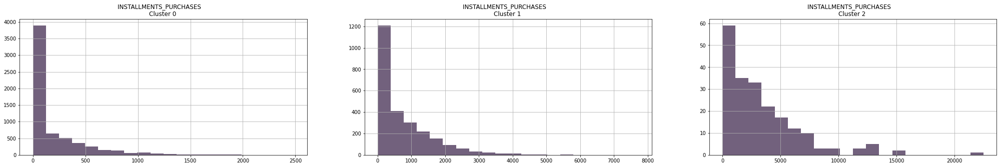

...

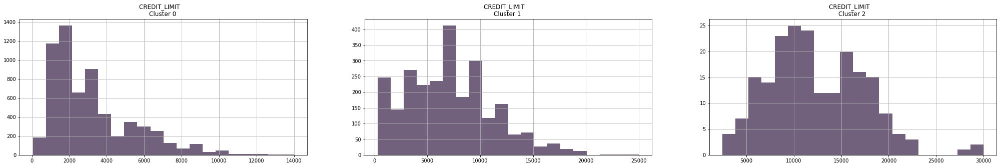

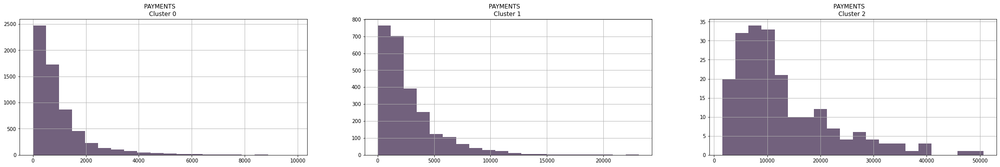

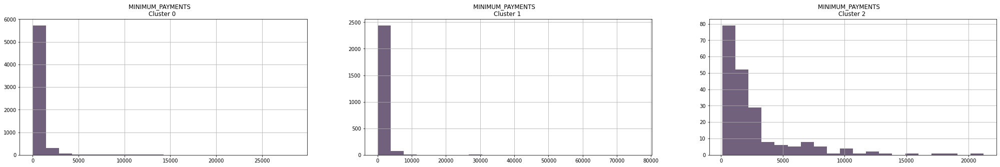

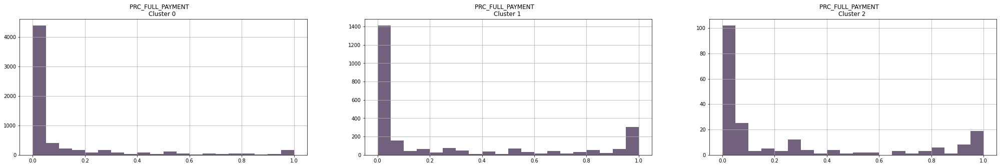

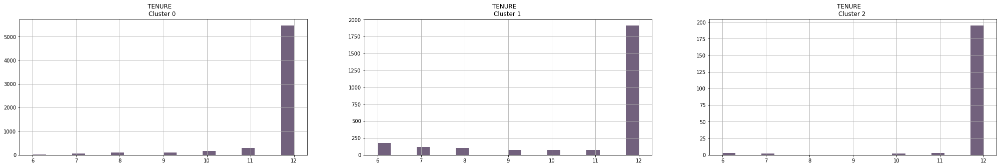

In [ ]:
# Plot the histogram of various clusters
for i in ccard_df.columns:
  plt.figure(figsize = (35, 5))
  for j in range(3):
    plt.subplot(1,3,j+1)
    cluster = ccard_df_autoenc_cluster[ccard_df_autoenc_cluster['Cluster'] == j]
    cluster[i].hist(bins = 20, color=Grape_Compote)
    plt.title('{}    \nCluster {} '.format(i,j))
  
  plt.show()

## Cluster Description

**Cluster 0** This cluster is more conservative in their use of the credit facility.  They have lower balances and credit limits.  

**Cluster 1** Cluster 1 is typically customers that the bank can target to grow into more frequent users, and increase their credit facility.  The are in the 'middle' of cluster 0 and cluster 2. 

**Cluster 2** This cluster is the bank's most lucrative clients.  They have the highest credit limit and most transactions with highest value of purchases. This cluster also keeps the higest balance in their credit cards. 

## Conclusion 

The three clusters identified above give a much clearer picture of the groups of clients that exist.  

The visualisations show tighter grouping and less scatter.  Cluster 2, however, does seem to be more dispersed that Cluster 0 and Cluster 1.  

These clusters should be tested against domain knowledge.  Using colleagues with knowledge of the company products and clients as sounding board to confirm findings is always worthwhile. 

# Method 3 : RFM Analysis

As was discussed in method 2, clustering is not a cure-all for customer segmentation, and should therefor always be coupled with a strong domain knowledge.  

To incorporate this factor, I decided to apply the **RFM (recency, frequency and monetary) analysis** technique. To perform this analysis we will proceed to divide the 17 features into 3 groups that represent recency, frequency and monetary values and calculate a score for each. 



The dataset, however, does not contain dates for any transactions, making it difficult to determine the **recency** aspect of the analysis.  This is where we will have to **engineer features** that simulate and/or represent recency. 

From the dataset description we learn that data was gathered over a **six month period** for these credit card users, so it seems reasonable to use  the **number of times** the clients transacted to represent the '**recency**' aspect of the analysis. 

For this analysis I will keep the math simple and work out a basic mean with **no special weights** attributed to any of the features. 

## Feature Engineering

For the Recency metric I will use:
CASH_ADVANCE_TRX, PURCHASES_TRX and TENURE




In [ ]:
recency_list = ['CASH_ADVANCE_TRX', 'PURCHASES_TRX', 'PRC_FULL_PAYMENT','TENURE']
recency_data = [ccard_df.CASH_ADVANCE_TRX, ccard_df.PURCHASES_TRX, ccard_df.PRC_FULL_PAYMENT,
                ccard_df.TENURE]
recency_df = pd.concat(recency_data, axis=1, keys=recency_list)
recency_df_scaled = scaler.fit_transform(recency_df)
recency_df_scaled.shape


(8950, 4)

In [ ]:
recency_df_scaled

array([[-0.47606982, -0.51133325, -0.52555097,  0.36067954],
       [ 0.11007385, -0.59179588,  0.2342269 ,  0.36067954],
       [-0.47606982, -0.10902012, -0.52555097,  0.36067954],
       ...,
       [-0.47606982, -0.39063931,  0.32919999, -4.12276757],
       [-0.18299798, -0.59179588,  0.32919999, -4.12276757],
       [-0.18299798,  0.33352433, -0.52555097, -4.12276757]])

For the Frequency metric I will use all the 5 features that measure frequency in the dataset. 

In [ ]:
frequency_list = ['BALANCE_FREQUENCY', 'PURCHASES_FREQUENCY', 'ONEOFF_PURCHASES_FREQUENCY',
                 'PURCHASE_INSTALLMENTS_FREQUENCY', 'CASH_ADVANCE_FREQUENCY']
frequency_data = [ccard_df.BALANCE_FREQUENCY, ccard_df.PURCHASES_FREQUENCY, 
                  ccard_df.ONEOFF_PURCHASES_FREQUENCY, ccard_df.PURCHASES_INSTALLMENTS_FREQUENCY, 
                  ccard_df.CASH_ADVANCE_FREQUENCY]
frequency_df = pd.concat(frequency_data, axis=1, keys=frequency_list)
frequency_df_scaled = scaler.fit_transform(frequency_df)
frequency_df_scaled.shape

(8950, 5)

In [ ]:
frequency_df_scaled

array([[-0.24943448, -0.80649035, -0.67866081, -0.70731317, -0.67534886],
       [ 0.13432467, -1.22175806, -0.67866081, -0.91699519,  0.57396272],
       [ 0.51808382,  1.26984323,  2.67345108, -0.91699519, -0.67534886],
       ...,
       [-0.18547673,  0.85457552, -0.67866081,  0.76046857, -0.67534886],
       [-0.18547673, -1.22175806, -0.67866081, -0.91699519,  0.15752719],
       [-0.88903307,  0.4393103 ,  1.55608157, -0.91699519,  0.99039825]])

The Monetary metric will be the mean of the 8 features that represent $-amounts spent and paid by each client. 

In [ ]:
monetary_list = ['BALANCE', 'PURCHASES', 'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES',
                 'CASH_ADVANCE', 'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS']
monetary_data = [ccard_df.BALANCE, ccard_df.PURCHASES, ccard_df.ONEOFF_PURCHASES,
                 ccard_df.INSTALLMENTS_PURCHASES, ccard_df.CASH_ADVANCE,
                 ccard_df.CREDIT_LIMIT, ccard_df.PAYMENTS, ccard_df.MINIMUM_PAYMENTS]
monetary_df = pd.concat(monetary_data, axis=1, keys=monetary_list)
monetary_df_scaled = scaler.fit_transform(monetary_df)
monetary_df_scaled.shape

(8950, 8)

In [ ]:
monetary_df_scaled

array([[-0.73198937, -0.42489974, -0.35693402, ..., -0.96043334,
        -0.52897879, -0.3024    ],
       [ 0.78696085, -0.46955188, -0.35693402, ...,  0.68863903,
         0.81864213,  0.09749953],
       [ 0.44713513, -0.10766823,  0.10888851, ...,  0.82606173,
        -0.38380474, -0.0932934 ],
       ...,
       [-0.7403981 , -0.40196519, -0.35693402, ..., -0.96043334,
        -0.5706145 , -0.32687479],
       [-0.74517423, -0.46955188, -0.35693402, ..., -1.09785604,
        -0.58053567, -0.33830497],
       [-0.57257511,  0.04214581,  0.30173158, ..., -0.90546427,
        -0.57686873, -0.3243581 ]])

In [ ]:
rfm_keys      = ['Recency', 'Frequency', 'Monetary']
rfm_data      = [pd.Series(recency_df_scaled.mean(axis=1)),
                pd.Series(frequency_df_scaled.mean(axis=1)), 
                pd.Series(monetary_df_scaled.mean(axis=1))]
rfm_df_scaled = pd.concat(rfm_data, axis=1, keys = rfm_keys)
rfm_df_scaled

,Recency,Frequency,Monetary
0,-0.288069,-0.623450,-0.515187
1,0.028296,-0.421825,0.464535
2,-0.187490,0.573807,-0.015505
3,-0.261492,-0.721261,0.000398
4,-0.298126,-0.497541,-0.452074
...,...,...,...
8945,-0.941324,0.322750,-0.476938
8946,-1.368699,0.322750,-0.463780
8947,-1.165069,0.015112,-0.514862
8948,-1.142090,-0.569073,-0.561536


##K-Means

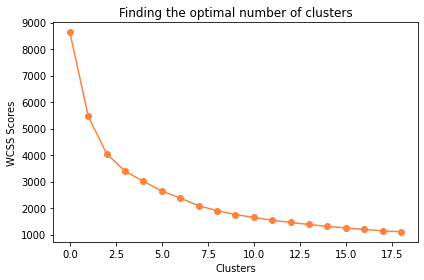

In [ ]:
rfm_scores = kmeans_optimal(rfm_df_scaled, 1, 20, Orange_Peel , '-')

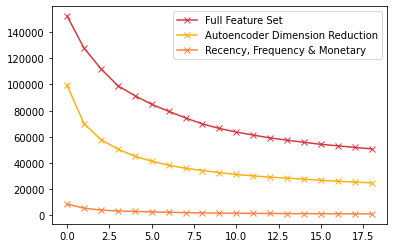

In [ ]:
plt.plot(cc_scores, 'bx-', color = Flame_Scarlet, label='Full Feature Set')
plt.plot(autoenc_scores, 'bx-', color = Saffron, label='Autoencoder Dimension Reduction')
plt.plot(rfm_scores, 'bx-', color = Orange_Peel, label='Recency, Frequency & Monetary')
plt.legend()

The RFM dataset's **'elbow'** looks like it is at *k=4*.  In keeping with the good practive of looking at k-1, k and k+1 we will run k-means for 3, 4 and 5.  

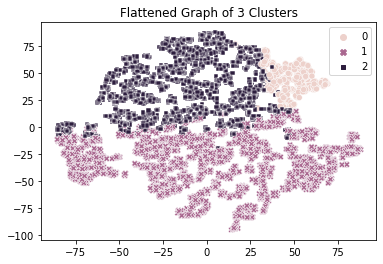

In [ ]:
rfm_labels, rfm_cluster_centers = kmeans(rfm_df_scaled, 3)

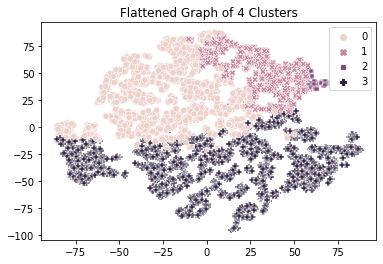

In [ ]:
rfm_labels, rfm_cluster_centers = kmeans(rfm_df_scaled, 4)

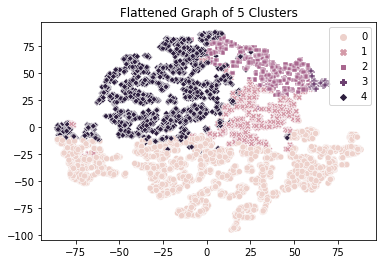

In [ ]:
rfm_labels, rfm_cluster_centers = kmeans(rfm_df_scaled, 5)

The clusters for k equal to all three values, 3, 4 and 5 are fitted tightly. For k equal to 4 and 5 though, there are very small clusters, again potentially causing a problem with the **k-means assumption** that all clusters must be similar in size. 

Optimal k of 3 seems like the more logical choice to continue with. 


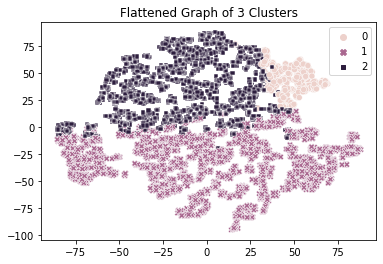

In [ ]:
rfm_labels, rfm_cluster_centers = kmeans(rfm_df_scaled, 3)

## 3D Visualisation

In [ ]:
rfm_df_scaled_cluster = rfm_df_scaled.assign(cluster = rfm_labels)
rfm_df_scaled_cluster

,Recency,Frequency,Monetary,cluster
0,-0.288069,-0.623450,-0.515187,1
1,0.028296,-0.421825,0.464535,1
2,-0.187490,0.573807,-0.015505,2
3,-0.261492,-0.721261,0.000398,1
4,-0.298126,-0.497541,-0.452074,1
...,...,...,...,...
8945,-0.941324,0.322750,-0.476938,1
8946,-1.368699,0.322750,-0.463780,1
8947,-1.165069,0.015112,-0.514862,1
8948,-1.142090,-0.569073,-0.561536,1


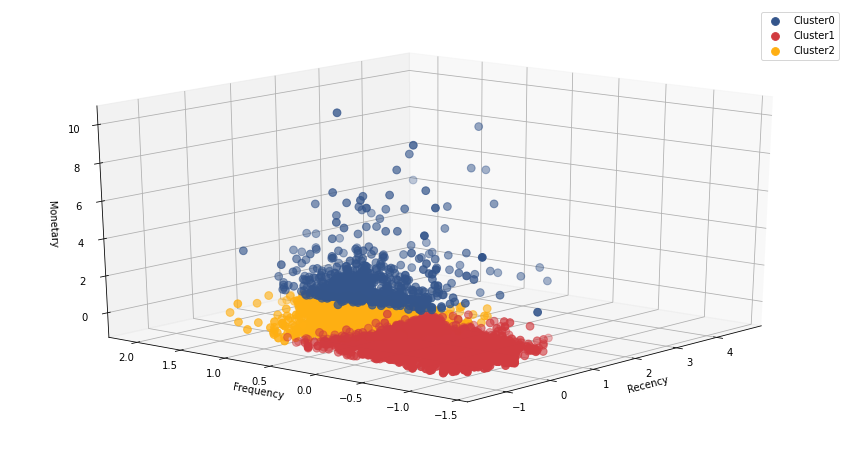

In [ ]:
fig = plt.figure(figsize=(15,8))
ax = fig.add_subplot(111, projection='3d')

scatter0 = ax.scatter(rfm_df_scaled_cluster.Recency[rfm_df_scaled_cluster.cluster==0], 
                      rfm_df_scaled_cluster.Frequency[rfm_df_scaled_cluster.cluster==0], 
                      rfm_df_scaled_cluster.Monetary[rfm_df_scaled_cluster.cluster==0],
                      c=Classic_Blue, s=60)
scatter1 = ax.scatter(rfm_df_scaled_cluster.Recency[rfm_df_scaled_cluster.cluster==1], 
                      rfm_df_scaled_cluster.Frequency[rfm_df_scaled_cluster.cluster==1], 
                      rfm_df_scaled_cluster.Monetary[rfm_df_scaled_cluster.cluster==1],
                      c=Flame_Scarlet, s=60)
scatter2 = ax.scatter(rfm_df_scaled_cluster.Recency[rfm_df_scaled_cluster.cluster==2], 
                      rfm_df_scaled_cluster.Frequency[rfm_df_scaled_cluster.cluster==2], 
                      rfm_df_scaled_cluster.Monetary[rfm_df_scaled_cluster.cluster==2],
                      c=Saffron, s=60)

ax.legend([scatter0, scatter1, scatter2, scatter3],
          ['Cluster0', 'Cluster1', 'Cluster2'],
          numpoints = 1)
ax.view_init(20, -140)
plt.xlabel('Recency')
plt.ylabel('Frequency')
ax.set_zlabel('Monetary')
plt.show()

## Visualise Features

### Clusters

In [ ]:
rfm_cluster_centers = pd.DataFrame(data=rfm_cluster_centers, columns = rfm_keys)
rfm_cluster_centers

#ccard_cluster_centres = scaler.inverse_transform(ccard_cluster_centres)
#ccard_cluster_centres = pd.DataFrame(data = ccard_cluster_centres, columns = ccard_columns)

,Recency,Frequency,Monetary
0,0.842388,0.745618,1.524385
1,-0.245916,-0.450335,-0.233356
2,0.152630,0.421858,0.015338


### Individual Features

In [ ]:
ccard_df_rfm_cluster = ccard_df.assign(Cluster = rfm_labels)
ccard_df_rfm_cluster

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Cluster
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,1
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,1
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,2
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,312.343947,0.000000,12,1
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6,1
8946,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,312.343947,0.000000,6,1
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6,1
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6,1


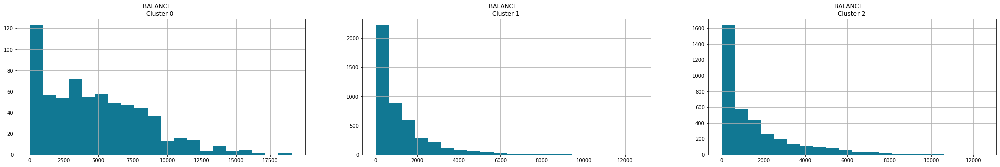

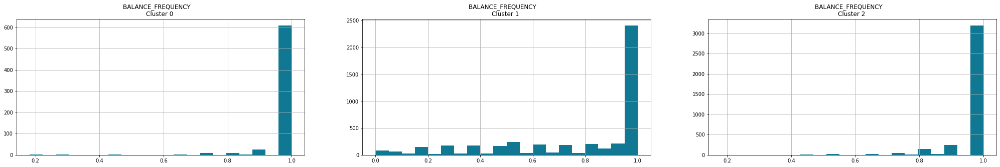

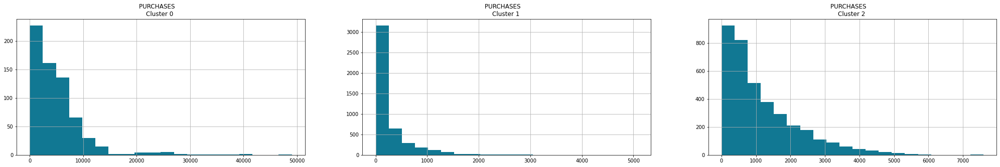

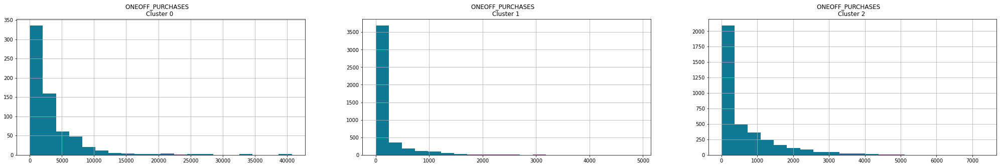

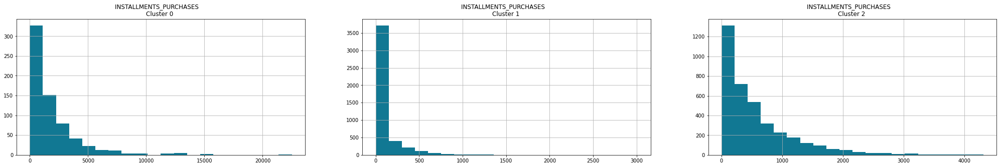

...

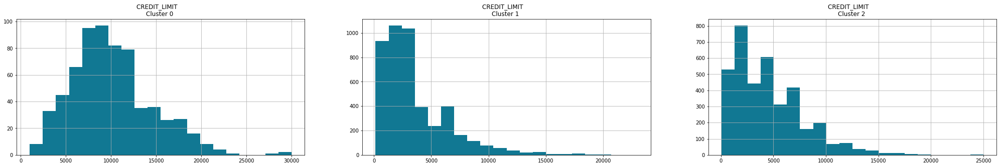

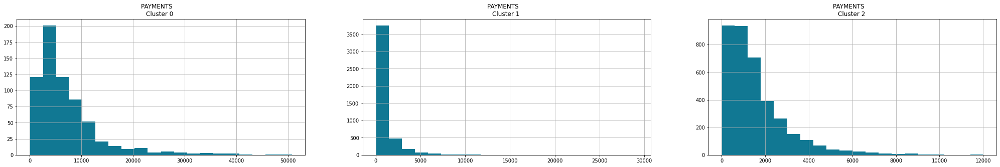

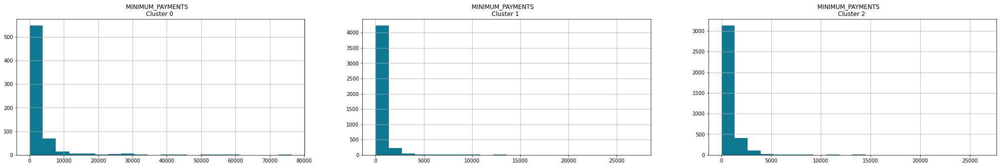

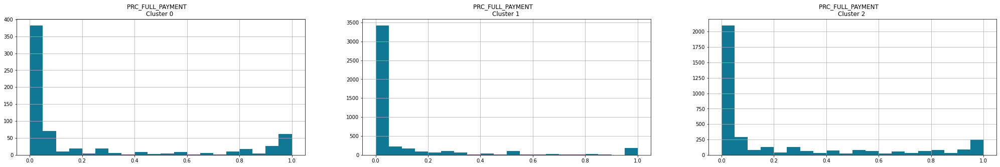

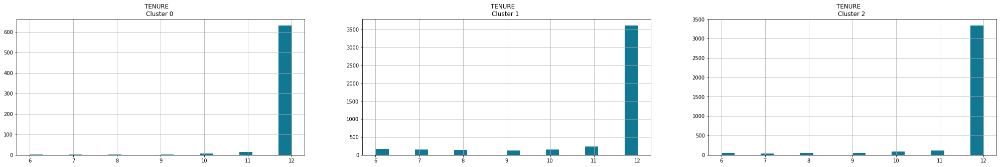

In [ ]:
# Plot the histogram of various clusters
for i in ccard_df.columns:
  plt.figure(figsize = (35, 5))
  for j in range(3):
    plt.subplot(1,3,j+1)
    cluster = ccard_df_rfm_cluster[ccard_df_rfm_cluster['Cluster'] == j]
    cluster[i].hist(bins = 20, color=Mosaic_Blue)
    plt.title('{}    \nCluster {} '.format(i,j))
  
  plt.show()

## Cluster Description

**Cluster 0** This cluster hosts clients with the highest credit limit. They use the credit card often - probably for day to day, use cash advance more often and makes the highest oneoff purchases. This is also the group with the highest balances in their accounts. The bank wants to ensure that they do not loose these clients. 

**Cluster 1** Conservative users with smaller balances, fewer purchases and smaller size purchases.  

**Cluster 2** This group does more frequent installment purchases, use the card on fairly often and has a credit limit between the first two clusters.  Keep a higher balance on their card than Cluster 1, but less than Cluster 0.  This is probably the group of users that the marketing team should focus on to grow into 

# Conclusion

The clusters in the second and third analysis seem to both hint to the existance of three distinct groups in the dataset.  This fact instills confidence that their probably are 3 types of clients in the dataset. 

There is one difference between the second and third methods, and that seems to be the size of the clusters.  While method 2 produces more uneven sized groups, method 3 produces more equal sized cohorts.  

From a theoretical perspective, method 3 would be the better approach, however, this is not might not be the case when we look at the actual clients.

This takes us back to a very important point. Clustering on it's own can be an exceptionally valuable tool but its true power willl come to light if it is coupled with extensive domain knowledge of the company and its products and   insights into the market. 